# GANomaly
- 2020.08.16 : gen 10 / lr 1e-2

# 개발일지
- 2020.08.15 : 분율 추출 구현 / 이상치 상관계수 추출 구현 / 모델 save, load 구현
- 2020.08.16 : anomaly detect 이미지 저장 구현 / 티타늄(Ti64) 상대 밀도 계산 구현

--- 

# Module

In [1]:
import torch
import torch.nn as nn
import torchvision
from torchvision import transforms
from torchvision.utils import save_image
import os
import numpy as np

import torchvision.datasets as dataset
import torchvision.transforms as transforms
import torchvision.utils as vutils

# Graph & Animation
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Hyper Parameter

In [2]:
latent_size = 100  # z벡터의 잠재공간(latent space)의 크기
workers = 4    # 0일때, 약 20% 사용 4일 경우 메모리 100%
img_size = 64
channel = 1
epochs = 100
batch_size = 64
learning_rate = 1e-2

# Data and Device

In [3]:
# 이미지 경로, 이미지들 리사이즈 및 텐서형태로 만들기
#data_root = "../../dataset/train"
CFRP_aug_data_root = "../../dataset/aug_train/aug_CFRP"

data_set = dataset.ImageFolder(root = CFRP_aug_data_root, # data_root,
                           transform = transforms.Compose([
                                  #transforms.Resize(img_size),
                                  transforms.CenterCrop(img_size),
                                  torchvision.transforms.Grayscale(channel),
                                  transforms.ToTensor(),
                                  transforms.Normalize((0.5,),(0.5,))
                              ]))

print("size of dataset :", len(data_set))

# 배치로 나누고 셔플하기
data_loader = torch.utils.data.DataLoader(data_set, batch_size = batch_size,
                                         shuffle = True, num_workers = workers, drop_last=True)

# Device setting (GPU or CPU)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print("device :", device)

size of dataset : 1368
device : cuda:0


# MODEL

In [4]:
# GANomaly : Generative Adversarial Networks Model using Decoder with AutoEncoder

# === Decoder 모델 ===
class Decoder(nn.Module):
    def __init__(self):
        super(Decoder,self).__init__()
        
        # Batch Normalization 유무에 따른 G_block 정의
        def DC_conv_block(in_features, out_features):
            block = [
                    nn.Conv2d(in_features, out_features, 3, 1, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU()
            ]
            return block
        
        def DC_deconv_block(in_features, out_features, FIRST=True):
            if FIRST:
                block = [
                    nn.ConvTranspose2d(in_features, out_features, 4, 1, 0, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU()
                ]
            else:
                block = [
                    nn.ConvTranspose2d(in_features, out_features, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU()
                ]
            return block
        
        
        # ======================= 픽셀 분포 생성 layer ======================= 
        self.DC_gen_distribution = nn.Sequential(
            # ------ input is latent_size 100 ------ 
            *DC_deconv_block(latent_size, img_size*8, FIRST=True),
            # ------ state size is 512x4x4 ------ 
            *DC_conv_block(img_size*8, img_size*8),
            # ------ state size is 512x4x4 ------   
            *DC_deconv_block(img_size*8, img_size*4, FIRST=False),
            # ------ state size is 256x8x8 ------ 
            *DC_conv_block(img_size*4, img_size*4),
            # ------ state size is 256x8x8 ------ 
            *DC_deconv_block(img_size*4, img_size*2, FIRST=False),
            # ------ state size is 128x16x16 ------ 
            *DC_conv_block(img_size*2, img_size*2),
            # ------ state size is 128x16x16 ------ 
            *DC_deconv_block(img_size*2, img_size, FIRST=False),
        )
        
        # =================== 가짜 이미지 생성 layer =================== 
        self.DC_gen_fake_img = nn.Sequential(
            # ------ state size is 64x32x32 ------ 
            nn.ConvTranspose2d(img_size, 1, 4, 2, 1, bias=False),
            nn.Tanh() # 픽셀값의 범위 : -1 ~ 1로 두기 위해서
            # ------ state size is 1x64x64 ------ 
        )
    
    def forward(self, input):
        distribution = self.DC_gen_distribution(input)
        fake_img = self.DC_gen_fake_img(distribution)
        
        return fake_img


# === Discriminator 모델 ===
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        # Batch Normalization 유무에 따른 D_block 정의
        def D_block(in_features, out_features, MP=True):
            if MP:
                block = [
                    nn.Conv2d(in_features, out_features, 3, 1, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU()
                ]
            else:
                block = [
                    nn.Conv2d(in_features, out_features, 3, 1, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU(),
                    nn.MaxPool2d(2)
                ]
            return block
        
        # ============== Feature 추출 layer ==============
        self.D_extract_feature = nn.Sequential(
            # ------ input is 1 x 64 x 64 ------ 
            *D_block(channel, img_size, MP=False),
            # ------ input is 64 x 64 x 64 ------ 
            *D_block(img_size, img_size, MP=True),
            # ------ state is 64 x 32 x 32 ------ 
            *D_block(img_size, img_size*2, MP=False),
            # ------ state is 128 x 32 x 32 ------ 
            *D_block(img_size*2, img_size*2, MP=True),
            # ------ state is 128 x 16 x 16 ------ 
            *D_block(img_size*2, img_size*4, MP=False),
            # ------ state is 256 x 16 x 16 ------ 
            *D_block(img_size*4, img_size*4, MP=True),
            # ------ state is 256 x 8 x 8 ------ 
            *D_block(img_size*4, img_size*8, MP=False),
            # ------ state is 512 x 8 x 8 ------ 
            *D_block(img_size*8, img_size*8, MP=True),
        )
        
        # ===================== 이진 분류 layer =====================
        self.D_classification = nn.Sequential(        
            # ------- state size 512x4x4 ------- 
            nn.Conv2d(img_size*8, channel, 4, 1, 0, bias=False),
            #nn.Linear(fms*8*4*4, 1, bias=False),
            nn.Sigmoid()        
        )
        
    def forward(self, input):
        feature = self.D_extract_feature(input)
        classification = self.D_classification(feature)
        
        return classification, feature 


# === Encoder Model ===
class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()
        
        def EC_block(in_features, out_features, MP=True):
            if MP:
                block = [
                    nn.Conv2d(in_features, out_features, 3, 1, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU()
                ]
            else:
                block = [
                    nn.Conv2d(in_features, out_features, 3, 1, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU(),
                    nn.MaxPool2d(2)
                ]
            return block
        
        # ============== Feature 추출 ==============
        self.EC_extract_feature = nn.Sequential(
            # ------ input is 1 x 64 x 64 ------ 
            *EC_block(channel, img_size, MP=False),
            # ------ input is 64 x 64 x 64 ------ 
            *EC_block(img_size, img_size, MP=True),
            # ------ state is 64 x 32 x 32 ------ 
            *EC_block(img_size, img_size*2, MP=False),
            # ------ state is 128 x 32 x 32 ------ 
            *EC_block(img_size*2, img_size*2, MP=True),
            # ------ state is 128 x 16 x 16 ------ 
            *EC_block(img_size*2, img_size*4, MP=False),
            # ------ state is 256 x 16 x 16 ------ 
            *EC_block(img_size*4, img_size*4, MP=True),
            # ------ state is 256 x 8 x 8 ------ 
            *EC_block(img_size*4, img_size*8, MP=False),
            # ------ state is 512 x 8 x 8 ------ 
            *EC_block(img_size*8, img_size*8, MP=True),
        )
        
        # =============== Encoder Training layer ===============
        self.EC_validate = nn.Sequential(
            # -------state is 512 x 4 x 4-------
            nn.Conv2d(img_size*8, latent_size, 4, 1, 0, bias=False),
            nn.Tanh()
            # -------state is 100 x 97 x 97-------
        )
        
    def forward(self, input):
        feature = self.EC_extract_feature(input)
        validity = self.EC_validate(feature)
        
        return validity

# Loss & Optim

In [5]:
# DC and D 무게 초기화, classname 에 찾는 name가 없다면 -1 ,
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


# D,DC,EC 네트워크 모델 객체 선언
D = Discriminator().to(device)
DC = Decoder().to(device)
EC = Encoder().to(device)

# weight initialize/ nn.Module 클래스 안에 apply 함수가 정의되 있음, 각 함수들에 다 적용 하게한다
D.apply(weights_init)
DC.apply(weights_init)
EC.apply(weights_init)

# Binary cross entropy loss and optimizer
DCGAN_criterion = nn.BCELoss()
AE_criterion = nn.MSELoss()

# latent vector에 배치 사이즈 64를 적용
# 학습한 DC로 새로운 것 만들어서 결과 확인 할때 사용
noise_z = torch.randn(img_size, latent_size, 1, 1, device = device)

# D와 DC에 대해 두가지 최적화 설정
D_optimizer = torch.optim.Adam(D.parameters(), lr = learning_rate, betas=(0.5,0.999))
DC_optimizer = torch.optim.Adam(DC.parameters(), lr = learning_rate, betas=(0.5,0.999))
EC_optimizer = torch.optim.Adam(EC.parameters(), lr = learning_rate, betas=(0.5,0.999))

#print(D)
#print(DC)
#print(EC)

def reset_grad():
    D_optimizer.zero_grad()
    DC_optimizer.zero_grad()

---

# Train DCGAN

In [6]:
img_list = []
DC_losses = []
D_losses = []
iters = 0

def train_DCGAN(epoch, learning_DC_per_D = 4):
    global epochs
    global iters
    
    # 인덱스 0부터 세기 시작
    # data[0].size():64x1x64x64(image) / data[1].size():64(label)
    for i,data in enumerate(data_loader,0):
        
        # Train D
        real_img = data[0].to(device) # image size: 64x1x64x64(batch, channel, width, height)
        b_size = real_img.size(0) # b_size = 64
        real_labels = torch.ones(b_size, 1).to(device)
        fake_labels = torch.zeros(b_size, 1).to(device)
        
        # (--------------------------real-----------------------------)
        real_classification, _ = D(real_img) # output = D(x)
        real_loss = DCGAN_criterion(real_classification, real_labels) # D(x)=1일 때의 loss
        real_score = real_classification
        D_x = real_score.mean().item() 
            
        # (--------------------------fake-----------------------------)
        z = torch.randn(b_size, latent_size, 1, 1).to(device) # z size :64x100x1x1
        fake_img = DC(z)
        fake_classification, _ = D(fake_img) # output = D(DC(z))
        fake_loss = DCGAN_criterion(fake_classification, fake_labels) # D(DC(z))=0일 때의 loss
        fake_score = fake_classification
        D_DC_z1 = fake_score.mean().item()

        # (------------------Backprop and optimize---------------------)
        D_loss = real_loss + fake_loss
        reset_grad()
        D_loss.backward()
        D_optimizer.step() # D(x)=1, D(DC(z))=0이어야 D가 최적

        
        # Train DC
        #z = torch.randn(b_size,latent_size,1,1,device=device) # z size :64x100x1x1
        for k in range(learning_DC_per_D):
            fake_img = DC(z)
            fake_classification,_ = D(fake_img)  # output : D(DC(z))
            D_DC_z2 = fake_classification.mean().item()
            DC_loss = DCGAN_criterion(fake_classification, real_labels) # D(DC(z))=1일 때의 loss=log(D(DC(z)))

            # (------------------Backprop and optimize---------------------)
            reset_grad()
            DC_loss.backward()
            DC_optimizer.step() # D(DC(z))=1 이어야 DC가 최적
            # ==> D(DC(z))의 값이 0.5로 수렴해야 한다.
        
        
        # print
        print('[%d/%d][%d/%d]\n- D_loss : %.4f / DC_loss : %.4f\n- D(x):%.4f / D(DC(z1)) : %.4f / D(DC(z2)) : %.4f' 
                   %(epoch+1, epochs, i, len(data_loader),D_loss.item(),
                     DC_loss.item(),D_x,D_DC_z1,D_DC_z2))
        
        # Save Losses for plotting later
        DC_losses.append(DC_loss.item())
        D_losses.append(D_loss.item())
        
        #Check how the generator is doing by saving G's output on noise_z
        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(data_loader)-1)):
            with torch.no_grad():
                fake = DC(noise_z).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1
        
#torch.save(E.state_dict(), 'E.ckpt')

In [7]:
for epoch in range(epochs):
    train_DCGAN(epoch, learning_DC_per_D = 10)

/home/piai/anaconda3/envs/pytorch/lib/python3.6/site-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([64, 1])) that is different to the input size (torch.Size([64, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


[1/100][0/21]
- D_loss : 1.3878 / DC_loss : 0.4912
- D(x):0.5012 / D(DC(z1)) : 0.5019 / D(DC(z2)) : 0.6119
[1/100][1/21]
- D_loss : 1.9512 / DC_loss : 0.6636
- D(x):0.3904 / D(DC(z1)) : 0.6245 / D(DC(z2)) : 0.5150
[1/100][2/21]
- D_loss : 1.9619 / DC_loss : 0.3127
- D(x):0.3001 / D(DC(z1)) : 0.5161 / D(DC(z2)) : 0.7315
[1/100][3/21]
- D_loss : 2.1695 / DC_loss : 0.5460
- D(x):0.4414 / D(DC(z1)) : 0.7313 / D(DC(z2)) : 0.5792
[1/100][4/21]
- D_loss : 1.5852 / DC_loss : 0.8891
- D(x):0.4885 / D(DC(z1)) : 0.5796 / D(DC(z2)) : 0.4110
[1/100][5/21]
- D_loss : 1.4445 / DC_loss : 0.6631
- D(x):0.4013 / D(DC(z1)) : 0.4121 / D(DC(z2)) : 0.5153
[1/100][6/21]
- D_loss : 1.4195 / DC_loss : 0.6194
- D(x):0.4991 / D(DC(z1)) : 0.5153 / D(DC(z2)) : 0.5383
[1/100][7/21]
- D_loss : 1.4097 / DC_loss : 0.6753
- D(x):0.5287 / D(DC(z1)) : 0.5381 / D(DC(z2)) : 0.5090
[1/100][8/21]
- D_loss : 1.3894 / DC_loss : 0.7199
- D(x):0.5033 / D(DC(z1)) : 0.5047 / D(DC(z2)) : 0.4868
[1/100][9/21]
- D_loss : 1.3807 / DC_

[4/100][14/21]
- D_loss : 1.3866 / DC_loss : 0.6926
- D(x):0.4989 / D(DC(z1)) : 0.4990 / D(DC(z2)) : 0.5003
[4/100][15/21]
- D_loss : 1.3863 / DC_loss : 0.6933
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4999
[4/100][16/21]
- D_loss : 1.3864 / DC_loss : 0.6950
- D(x):0.4998 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.4991
[4/100][17/21]
- D_loss : 1.3864 / DC_loss : 0.6922
- D(x):0.4990 / D(DC(z1)) : 0.4990 / D(DC(z2)) : 0.5004
[4/100][18/21]
- D_loss : 1.3866 / DC_loss : 0.6924
- D(x):0.5003 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.5004
[4/100][19/21]
- D_loss : 1.3864 / DC_loss : 0.6941
- D(x):0.5003 / D(DC(z1)) : 0.5003 / D(DC(z2)) : 0.4995
[4/100][20/21]
- D_loss : 1.3865 / DC_loss : 0.6921
- D(x):0.4994 / D(DC(z1)) : 0.4995 / D(DC(z2)) : 0.5005
[5/100][0/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5005 / D(DC(z1)) : 0.5005 / D(DC(z2)) : 0.4998
[5/100][1/21]
- D_loss : 1.3863 / DC_loss : 0.6920
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5006
[5/100][2/21]
- D_loss : 1.386

[8/100][7/21]
- D_loss : 1.3855 / DC_loss : 0.6900
- D(x):0.5019 / D(DC(z1)) : 0.5015 / D(DC(z2)) : 0.5016
[8/100][8/21]
- D_loss : 1.3862 / DC_loss : 0.6937
- D(x):0.5011 / D(DC(z1)) : 0.5010 / D(DC(z2)) : 0.4997
[8/100][9/21]
- D_loss : 1.3864 / DC_loss : 0.6899
- D(x):0.4992 / D(DC(z1)) : 0.4992 / D(DC(z2)) : 0.5016
[8/100][10/21]
- D_loss : 1.3877 / DC_loss : 0.6948
- D(x):0.5007 / D(DC(z1)) : 0.5014 / D(DC(z2)) : 0.4992
[8/100][11/21]
- D_loss : 1.3876 / DC_loss : 0.6905
- D(x):0.4984 / D(DC(z1)) : 0.4990 / D(DC(z2)) : 0.5013
[8/100][12/21]
- D_loss : 1.3866 / DC_loss : 0.6954
- D(x):0.5008 / D(DC(z1)) : 0.5010 / D(DC(z2)) : 0.4989
[8/100][13/21]
- D_loss : 1.3870 / DC_loss : 0.6914
- D(x):0.4985 / D(DC(z1)) : 0.4988 / D(DC(z2)) : 0.5009
[8/100][14/21]
- D_loss : 1.3864 / DC_loss : 0.6924
- D(x):0.5006 / D(DC(z1)) : 0.5007 / D(DC(z2)) : 0.5004
[8/100][15/21]
- D_loss : 1.3867 / DC_loss : 0.6957
- D(x):0.5001 / D(DC(z1)) : 0.5003 / D(DC(z2)) : 0.4987
[8/100][16/21]
- D_loss : 1.386

[11/100][20/21]
- D_loss : 1.3864 / DC_loss : 0.6947
- D(x):0.5005 / D(DC(z1)) : 0.5006 / D(DC(z2)) : 0.4992
[12/100][0/21]
- D_loss : 1.3864 / DC_loss : 0.6914
- D(x):0.4992 / D(DC(z1)) : 0.4992 / D(DC(z2)) : 0.5009
[12/100][1/21]
- D_loss : 1.3865 / DC_loss : 0.6957
- D(x):0.5008 / D(DC(z1)) : 0.5009 / D(DC(z2)) : 0.4987
[12/100][2/21]
- D_loss : 1.3863 / DC_loss : 0.6904
- D(x):0.4987 / D(DC(z1)) : 0.4987 / D(DC(z2)) : 0.5014
[12/100][3/21]
- D_loss : 1.3864 / DC_loss : 0.6956
- D(x):0.5013 / D(DC(z1)) : 0.5014 / D(DC(z2)) : 0.4988
[12/100][4/21]
- D_loss : 1.3864 / DC_loss : 0.6907
- D(x):0.4987 / D(DC(z1)) : 0.4987 / D(DC(z2)) : 0.5012
[12/100][5/21]
- D_loss : 1.3864 / DC_loss : 0.6949
- D(x):0.5012 / D(DC(z1)) : 0.5012 / D(DC(z2)) : 0.4991
[12/100][6/21]
- D_loss : 1.3863 / DC_loss : 0.6920
- D(x):0.4991 / D(DC(z1)) : 0.4991 / D(DC(z2)) : 0.5006
[12/100][7/21]
- D_loss : 1.3863 / DC_loss : 0.6931
- D(x):0.5006 / D(DC(z1)) : 0.5006 / D(DC(z2)) : 0.5000
[12/100][8/21]
- D_loss : 1

[15/100][12/21]
- D_loss : 1.3864 / DC_loss : 0.7029
- D(x):0.5043 / D(DC(z1)) : 0.5044 / D(DC(z2)) : 0.4952
[15/100][13/21]
- D_loss : 1.3863 / DC_loss : 0.6828
- D(x):0.4952 / D(DC(z1)) : 0.4952 / D(DC(z2)) : 0.5052
[15/100][14/21]
- D_loss : 1.3864 / DC_loss : 0.7028
- D(x):0.5052 / D(DC(z1)) : 0.5052 / D(DC(z2)) : 0.4952
[15/100][15/21]
- D_loss : 1.3864 / DC_loss : 0.6847
- D(x):0.4952 / D(DC(z1)) : 0.4952 / D(DC(z2)) : 0.5042
[15/100][16/21]
- D_loss : 1.3864 / DC_loss : 0.6986
- D(x):0.5042 / D(DC(z1)) : 0.5042 / D(DC(z2)) : 0.4973
[15/100][17/21]
- D_loss : 1.3864 / DC_loss : 0.6912
- D(x):0.4972 / D(DC(z1)) : 0.4973 / D(DC(z2)) : 0.5010
[15/100][18/21]
- D_loss : 1.3863 / DC_loss : 0.6932
- D(x):0.5009 / D(DC(z1)) : 0.5009 / D(DC(z2)) : 0.5000
[15/100][19/21]
- D_loss : 1.3864 / DC_loss : 0.6957
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.4987
[15/100][20/21]
- D_loss : 1.3863 / DC_loss : 0.6907
- D(x):0.4987 / D(DC(z1)) : 0.4987 / D(DC(z2)) : 0.5012
[16/100][0/21]
- D_

[19/100][4/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5000 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.4998
[19/100][5/21]
- D_loss : 1.3863 / DC_loss : 0.6927
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5002
[19/100][6/21]
- D_loss : 1.3863 / DC_loss : 0.6929
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.5001
[19/100][7/21]
- D_loss : 1.3863 / DC_loss : 0.6931
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.5000
[19/100][8/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.4998
[19/100][9/21]
- D_loss : 1.3863 / DC_loss : 0.6922
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5005
[19/100][10/21]
- D_loss : 1.3863 / DC_loss : 0.6939
- D(x):0.5005 / D(DC(z1)) : 0.5005 / D(DC(z2)) : 0.4996
[19/100][11/21]
- D_loss : 1.3863 / DC_loss : 0.6921
- D(x):0.4996 / D(DC(z1)) : 0.4996 / D(DC(z2)) : 0.5005
[19/100][12/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5005 / D(DC(z1)) : 0.5005 / D(DC(z2)) : 0.4998
[19/100][13/21]
- D_loss 

[22/100][17/21]
- D_loss : 1.3863 / DC_loss : 0.6967
- D(x):0.5021 / D(DC(z1)) : 0.5021 / D(DC(z2)) : 0.4982
[22/100][18/21]
- D_loss : 1.3863 / DC_loss : 0.6910
- D(x):0.4982 / D(DC(z1)) : 0.4982 / D(DC(z2)) : 0.5011
[22/100][19/21]
- D_loss : 1.3863 / DC_loss : 0.6939
- D(x):0.5011 / D(DC(z1)) : 0.5011 / D(DC(z2)) : 0.4996
[22/100][20/21]
- D_loss : 1.3864 / DC_loss : 0.6938
- D(x):0.4996 / D(DC(z1)) : 0.4996 / D(DC(z2)) : 0.4997
[23/100][0/21]
- D_loss : 1.3863 / DC_loss : 0.6918
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5007
[23/100][1/21]
- D_loss : 1.3863 / DC_loss : 0.6951
- D(x):0.5006 / D(DC(z1)) : 0.5007 / D(DC(z2)) : 0.4990
[23/100][2/21]
- D_loss : 1.3863 / DC_loss : 0.6918
- D(x):0.4990 / D(DC(z1)) : 0.4990 / D(DC(z2)) : 0.5007
[23/100][3/21]
- D_loss : 1.3863 / DC_loss : 0.6943
- D(x):0.5007 / D(DC(z1)) : 0.5007 / D(DC(z2)) : 0.4994
[23/100][4/21]
- D_loss : 1.3863 / DC_loss : 0.6922
- D(x):0.4994 / D(DC(z1)) : 0.4994 / D(DC(z2)) : 0.5005
[23/100][5/21]
- D_loss 

[26/100][9/21]
- D_loss : 1.3863 / DC_loss : 0.6910
- D(x):0.4989 / D(DC(z1)) : 0.4990 / D(DC(z2)) : 0.5011
[26/100][10/21]
- D_loss : 1.3863 / DC_loss : 0.6955
- D(x):0.5010 / D(DC(z1)) : 0.5011 / D(DC(z2)) : 0.4988
[26/100][11/21]
- D_loss : 1.3863 / DC_loss : 0.6899
- D(x):0.4988 / D(DC(z1)) : 0.4988 / D(DC(z2)) : 0.5016
[26/100][12/21]
- D_loss : 1.3863 / DC_loss : 0.6964
- D(x):0.5016 / D(DC(z1)) : 0.5016 / D(DC(z2)) : 0.4984
[26/100][13/21]
- D_loss : 1.3863 / DC_loss : 0.6898
- D(x):0.4983 / D(DC(z1)) : 0.4983 / D(DC(z2)) : 0.5017
[26/100][14/21]
- D_loss : 1.3863 / DC_loss : 0.6971
- D(x):0.5017 / D(DC(z1)) : 0.5017 / D(DC(z2)) : 0.4980
[26/100][15/21]
- D_loss : 1.3863 / DC_loss : 0.6891
- D(x):0.4980 / D(DC(z1)) : 0.4980 / D(DC(z2)) : 0.5020
[26/100][16/21]
- D_loss : 1.3863 / DC_loss : 0.6962
- D(x):0.5020 / D(DC(z1)) : 0.5020 / D(DC(z2)) : 0.4985
[26/100][17/21]
- D_loss : 1.3863 / DC_loss : 0.6905
- D(x):0.4985 / D(DC(z1)) : 0.4985 / D(DC(z2)) : 0.5013
[26/100][18/21]
- D_

[30/100][1/21]
- D_loss : 1.3863 / DC_loss : 0.6927
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5002
[30/100][2/21]
- D_loss : 1.3863 / DC_loss : 0.6934
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4999
[30/100][3/21]
- D_loss : 1.3863 / DC_loss : 0.6931
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5000
[30/100][4/21]
- D_loss : 1.3863 / DC_loss : 0.6931
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.5000
[30/100][5/21]
- D_loss : 1.3863 / DC_loss : 0.6932
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.5000
[30/100][6/21]
- D_loss : 1.3863 / DC_loss : 0.6929
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.5001
[30/100][7/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.4998
[30/100][8/21]
- D_loss : 1.3863 / DC_loss : 0.6930
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5001
[30/100][9/21]
- D_loss : 1.3863 / DC_loss : 0.6931
- D(x):0.5000 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.5000
[30/100][10/21]
- D_loss : 1

[33/100][14/21]
- D_loss : 1.3863 / DC_loss : 0.6932
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.5000
[33/100][15/21]
- D_loss : 1.3863 / DC_loss : 0.6933
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.4999
[33/100][16/21]
- D_loss : 1.3863 / DC_loss : 0.6929
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5001
[33/100][17/21]
- D_loss : 1.3863 / DC_loss : 0.6930
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.5001
[33/100][18/21]
- D_loss : 1.3863 / DC_loss : 0.6925
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.5003
[33/100][19/21]
- D_loss : 1.3863 / DC_loss : 0.6932
- D(x):0.5003 / D(DC(z1)) : 0.5003 / D(DC(z2)) : 0.5000
[33/100][20/21]
- D_loss : 1.3863 / DC_loss : 0.6927
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.5002
[34/100][0/21]
- D_loss : 1.3863 / DC_loss : 0.6937
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4997
[34/100][1/21]
- D_loss : 1.3863 / DC_loss : 0.6930
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5001
[34/100][2/21]
- D_lo

[37/100][6/21]
- D_loss : 1.3863 / DC_loss : 0.6923
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5004
[37/100][7/21]
- D_loss : 1.3863 / DC_loss : 0.6937
- D(x):0.5004 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.4997
[37/100][8/21]
- D_loss : 1.3863 / DC_loss : 0.6928
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5002
[37/100][9/21]
- D_loss : 1.3863 / DC_loss : 0.6936
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4998
[37/100][10/21]
- D_loss : 1.3863 / DC_loss : 0.6927
- D(x):0.4997 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5002
[37/100][11/21]
- D_loss : 1.3863 / DC_loss : 0.6934
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4999
[37/100][12/21]
- D_loss : 1.3863 / DC_loss : 0.6925
- D(x):0.4998 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5003
[37/100][13/21]
- D_loss : 1.3863 / DC_loss : 0.6933
- D(x):0.5003 / D(DC(z1)) : 0.5003 / D(DC(z2)) : 0.4999
[37/100][14/21]
- D_loss : 1.3863 / DC_loss : 0.6932
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5000
[37/100][15/21]
- D_los

[40/100][19/21]
- D_loss : 1.3863 / DC_loss : 0.6923
- D(x):0.4996 / D(DC(z1)) : 0.4996 / D(DC(z2)) : 0.5004
[40/100][20/21]
- D_loss : 1.3863 / DC_loss : 0.6937
- D(x):0.5004 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.4997
[41/100][0/21]
- D_loss : 1.3863 / DC_loss : 0.6928
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5002
[41/100][1/21]
- D_loss : 1.3863 / DC_loss : 0.6932
- D(x):0.5001 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.5000
[41/100][2/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.4998
[41/100][3/21]
- D_loss : 1.3863 / DC_loss : 0.6929
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5001
[41/100][4/21]
- D_loss : 1.3863 / DC_loss : 0.6936
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.4998
[41/100][5/21]
- D_loss : 1.3863 / DC_loss : 0.6924
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5004
[41/100][6/21]
- D_loss : 1.3863 / DC_loss : 0.6944
- D(x):0.5004 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.4994
[41/100][7/21]
- D_loss : 

[44/100][11/21]
- D_loss : 1.3863 / DC_loss : 0.6932
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.5000
[44/100][12/21]
- D_loss : 1.3863 / DC_loss : 0.6931
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.5000
[44/100][13/21]
- D_loss : 1.3863 / DC_loss : 0.6930
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.5001
[44/100][14/21]
- D_loss : 1.3863 / DC_loss : 0.6936
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.4998
[44/100][15/21]
- D_loss : 1.3863 / DC_loss : 0.6926
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5003
[44/100][16/21]
- D_loss : 1.3863 / DC_loss : 0.6934
- D(x):0.5003 / D(DC(z1)) : 0.5003 / D(DC(z2)) : 0.4999
[44/100][17/21]
- D_loss : 1.3863 / DC_loss : 0.6923
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5004
[44/100][18/21]
- D_loss : 1.3863 / DC_loss : 0.6942
- D(x):0.5004 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.4995
[44/100][19/21]
- D_loss : 1.3863 / DC_loss : 0.6922
- D(x):0.4995 / D(DC(z1)) : 0.4995 / D(DC(z2)) : 0.5005
[44/100][20/21]
- D

[48/100][3/21]
- D_loss : 1.3863 / DC_loss : 0.6912
- D(x):0.4992 / D(DC(z1)) : 0.4992 / D(DC(z2)) : 0.5010
[48/100][4/21]
- D_loss : 1.3863 / DC_loss : 0.6953
- D(x):0.5010 / D(DC(z1)) : 0.5010 / D(DC(z2)) : 0.4989
[48/100][5/21]
- D_loss : 1.3863 / DC_loss : 0.6913
- D(x):0.4989 / D(DC(z1)) : 0.4989 / D(DC(z2)) : 0.5009
[48/100][6/21]
- D_loss : 1.3863 / DC_loss : 0.6948
- D(x):0.5009 / D(DC(z1)) : 0.5009 / D(DC(z2)) : 0.4992
[48/100][7/21]
- D_loss : 1.3863 / DC_loss : 0.6917
- D(x):0.4992 / D(DC(z1)) : 0.4992 / D(DC(z2)) : 0.5007
[48/100][8/21]
- D_loss : 1.3863 / DC_loss : 0.6944
- D(x):0.5007 / D(DC(z1)) : 0.5007 / D(DC(z2)) : 0.4994
[48/100][9/21]
- D_loss : 1.3863 / DC_loss : 0.6919
- D(x):0.4994 / D(DC(z1)) : 0.4994 / D(DC(z2)) : 0.5006
[48/100][10/21]
- D_loss : 1.3863 / DC_loss : 0.6941
- D(x):0.5006 / D(DC(z1)) : 0.5006 / D(DC(z2)) : 0.4995
[48/100][11/21]
- D_loss : 1.3863 / DC_loss : 0.6922
- D(x):0.4995 / D(DC(z1)) : 0.4995 / D(DC(z2)) : 0.5005
[48/100][12/21]
- D_loss :

[51/100][16/21]
- D_loss : 1.3863 / DC_loss : 0.6936
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4998
[51/100][17/21]
- D_loss : 1.3863 / DC_loss : 0.6927
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5002
[51/100][18/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4998
[51/100][19/21]
- D_loss : 1.3863 / DC_loss : 0.6928
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5002
[51/100][20/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4998
[52/100][0/21]
- D_loss : 1.3863 / DC_loss : 0.6928
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5002
[52/100][1/21]
- D_loss : 1.3863 / DC_loss : 0.6936
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4998
[52/100][2/21]
- D_loss : 1.3863 / DC_loss : 0.6918
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5007
[52/100][3/21]
- D_loss : 1.3863 / DC_loss : 0.6946
- D(x):0.5007 / D(DC(z1)) : 0.5007 / D(DC(z2)) : 0.4993
[52/100][4/21]
- D_loss

[55/100][8/21]
- D_loss : 1.3863 / DC_loss : 0.6930
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.5001
[55/100][9/21]
- D_loss : 1.3863 / DC_loss : 0.6936
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.4998
[55/100][10/21]
- D_loss : 1.3863 / DC_loss : 0.6928
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5002
[55/100][11/21]
- D_loss : 1.3863 / DC_loss : 0.6931
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.5000
[55/100][12/21]
- D_loss : 1.3863 / DC_loss : 0.6936
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.4998
[55/100][13/21]
- D_loss : 1.3863 / DC_loss : 0.6928
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5002
[55/100][14/21]
- D_loss : 1.3863 / DC_loss : 0.6938
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4997
[55/100][15/21]
- D_loss : 1.3863 / DC_loss : 0.6927
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5002
[55/100][16/21]
- D_loss : 1.3863 / DC_loss : 0.6937
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4997
[55/100][17/21]
- D_l

[59/100][0/21]
- D_loss : 1.3863 / DC_loss : 0.6938
- D(x):0.5003 / D(DC(z1)) : 0.5003 / D(DC(z2)) : 0.4997
[59/100][1/21]
- D_loss : 1.3863 / DC_loss : 0.6926
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5003
[59/100][2/21]
- D_loss : 1.3863 / DC_loss : 0.6929
- D(x):0.5003 / D(DC(z1)) : 0.5003 / D(DC(z2)) : 0.5001
[59/100][3/21]
- D_loss : 1.3863 / DC_loss : 0.6939
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.4996
[59/100][4/21]
- D_loss : 1.3863 / DC_loss : 0.6922
- D(x):0.4996 / D(DC(z1)) : 0.4996 / D(DC(z2)) : 0.5005
[59/100][5/21]
- D_loss : 1.3863 / DC_loss : 0.6942
- D(x):0.5005 / D(DC(z1)) : 0.5005 / D(DC(z2)) : 0.4995
[59/100][6/21]
- D_loss : 1.3863 / DC_loss : 0.6919
- D(x):0.4995 / D(DC(z1)) : 0.4995 / D(DC(z2)) : 0.5006
[59/100][7/21]
- D_loss : 1.3863 / DC_loss : 0.6944
- D(x):0.5006 / D(DC(z1)) : 0.5006 / D(DC(z2)) : 0.4993
[59/100][8/21]
- D_loss : 1.3863 / DC_loss : 0.6920
- D(x):0.4993 / D(DC(z1)) : 0.4993 / D(DC(z2)) : 0.5006
[59/100][9/21]
- D_loss : 1.

[62/100][13/21]
- D_loss : 1.3863 / DC_loss : 0.6953
- D(x):0.5012 / D(DC(z1)) : 0.5012 / D(DC(z2)) : 0.4989
[62/100][14/21]
- D_loss : 1.3863 / DC_loss : 0.6913
- D(x):0.4989 / D(DC(z1)) : 0.4989 / D(DC(z2)) : 0.5009
[62/100][15/21]
- D_loss : 1.3863 / DC_loss : 0.6947
- D(x):0.5009 / D(DC(z1)) : 0.5009 / D(DC(z2)) : 0.4992
[62/100][16/21]
- D_loss : 1.3863 / DC_loss : 0.6919
- D(x):0.4992 / D(DC(z1)) : 0.4992 / D(DC(z2)) : 0.5006
[62/100][17/21]
- D_loss : 1.3863 / DC_loss : 0.6941
- D(x):0.5006 / D(DC(z1)) : 0.5006 / D(DC(z2)) : 0.4995
[62/100][18/21]
- D_loss : 1.3863 / DC_loss : 0.6923
- D(x):0.4995 / D(DC(z1)) : 0.4995 / D(DC(z2)) : 0.5004
[62/100][19/21]
- D_loss : 1.3863 / DC_loss : 0.6940
- D(x):0.5004 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.4996
[62/100][20/21]
- D_loss : 1.3863 / DC_loss : 0.6924
- D(x):0.4996 / D(DC(z1)) : 0.4996 / D(DC(z2)) : 0.5004
[63/100][0/21]
- D_loss : 1.3863 / DC_loss : 0.6937
- D(x):0.5004 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.4997
[63/100][1/21]
- D_l

[66/100][5/21]
- D_loss : 1.3863 / DC_loss : 0.6934
- D(x):0.5003 / D(DC(z1)) : 0.5003 / D(DC(z2)) : 0.4999
[66/100][6/21]
- D_loss : 1.3863 / DC_loss : 0.6929
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5001
[66/100][7/21]
- D_loss : 1.3863 / DC_loss : 0.6933
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.4999
[66/100][8/21]
- D_loss : 1.3863 / DC_loss : 0.6931
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5000
[66/100][9/21]
- D_loss : 1.3863 / DC_loss : 0.6934
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.4999
[66/100][10/21]
- D_loss : 1.3863 / DC_loss : 0.6931
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5000
[66/100][11/21]
- D_loss : 1.3863 / DC_loss : 0.6934
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.4999
[66/100][12/21]
- D_loss : 1.3863 / DC_loss : 0.6923
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5004
[66/100][13/21]
- D_loss : 1.3863 / DC_loss : 0.6940
- D(x):0.5004 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.4996
[66/100][14/21]
- D_loss

[69/100][18/21]
- D_loss : 1.3863 / DC_loss : 0.6918
- D(x):0.4992 / D(DC(z1)) : 0.4992 / D(DC(z2)) : 0.5007
[69/100][19/21]
- D_loss : 1.3863 / DC_loss : 0.6947
- D(x):0.5007 / D(DC(z1)) : 0.5007 / D(DC(z2)) : 0.4992
[69/100][20/21]
- D_loss : 1.3863 / DC_loss : 0.6918
- D(x):0.4992 / D(DC(z1)) : 0.4992 / D(DC(z2)) : 0.5006
[70/100][0/21]
- D_loss : 1.3863 / DC_loss : 0.6943
- D(x):0.5006 / D(DC(z1)) : 0.5006 / D(DC(z2)) : 0.4994
[70/100][1/21]
- D_loss : 1.3863 / DC_loss : 0.6922
- D(x):0.4994 / D(DC(z1)) : 0.4994 / D(DC(z2)) : 0.5005
[70/100][2/21]
- D_loss : 1.3863 / DC_loss : 0.6939
- D(x):0.5005 / D(DC(z1)) : 0.5005 / D(DC(z2)) : 0.4996
[70/100][3/21]
- D_loss : 1.3863 / DC_loss : 0.6925
- D(x):0.4996 / D(DC(z1)) : 0.4996 / D(DC(z2)) : 0.5003
[70/100][4/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5003 / D(DC(z1)) : 0.5003 / D(DC(z2)) : 0.4998
[70/100][5/21]
- D_loss : 1.3863 / DC_loss : 0.6927
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5002
[70/100][6/21]
- D_loss :

[73/100][10/21]
- D_loss : 1.3863 / DC_loss : 0.6937
- D(x):0.5003 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.4997
[73/100][11/21]
- D_loss : 1.3863 / DC_loss : 0.6928
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5002
[73/100][12/21]
- D_loss : 1.3863 / DC_loss : 0.6933
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.4999
[73/100][13/21]
- D_loss : 1.3863 / DC_loss : 0.6932
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5000
[73/100][14/21]
- D_loss : 1.3863 / DC_loss : 0.6932
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.5000
[73/100][15/21]
- D_loss : 1.3863 / DC_loss : 0.6929
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.5001
[73/100][16/21]
- D_loss : 1.3863 / DC_loss : 0.6931
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.5000
[73/100][17/21]
- D_loss : 1.3863 / DC_loss : 0.6934
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.4999
[73/100][18/21]
- D_loss : 1.3863 / DC_loss : 0.6928
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5002
[73/100][19/21]
- D

[77/100][2/21]
- D_loss : 1.3863 / DC_loss : 0.6940
- D(x):0.5004 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.4996
[77/100][3/21]
- D_loss : 1.3863 / DC_loss : 0.6923
- D(x):0.4996 / D(DC(z1)) : 0.4996 / D(DC(z2)) : 0.5004
[77/100][4/21]
- D_loss : 1.3863 / DC_loss : 0.6941
- D(x):0.5004 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.4995
[77/100][5/21]
- D_loss : 1.3863 / DC_loss : 0.6923
- D(x):0.4995 / D(DC(z1)) : 0.4995 / D(DC(z2)) : 0.5004
[77/100][6/21]
- D_loss : 1.3863 / DC_loss : 0.6939
- D(x):0.5004 / D(DC(z1)) : 0.5004 / D(DC(z2)) : 0.4996
[77/100][7/21]
- D_loss : 1.3863 / DC_loss : 0.6926
- D(x):0.4996 / D(DC(z1)) : 0.4996 / D(DC(z2)) : 0.5003
[77/100][8/21]
- D_loss : 1.3863 / DC_loss : 0.6936
- D(x):0.5003 / D(DC(z1)) : 0.5003 / D(DC(z2)) : 0.4998
[77/100][9/21]
- D_loss : 1.3863 / DC_loss : 0.6927
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5002
[77/100][10/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4998
[77/100][11/21]
- D_loss : 

[80/100][15/21]
- D_loss : 1.3863 / DC_loss : 0.6930
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5001
[80/100][16/21]
- D_loss : 1.3863 / DC_loss : 0.6932
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.5000
[80/100][17/21]
- D_loss : 1.3863 / DC_loss : 0.6931
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.5000
[80/100][18/21]
- D_loss : 1.3863 / DC_loss : 0.6933
- D(x):0.5000 / D(DC(z1)) : 0.5000 / D(DC(z2)) : 0.4999
[80/100][19/21]
- D_loss : 1.3863 / DC_loss : 0.6929
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5001
[80/100][20/21]
- D_loss : 1.3863 / DC_loss : 0.6934
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.4999
[81/100][0/21]
- D_loss : 1.3863 / DC_loss : 0.6929
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5001
[81/100][1/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.4998
[81/100][2/21]
- D_loss : 1.3863 / DC_loss : 0.6930
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5001
[81/100][3/21]
- D_los

[84/100][7/21]
- D_loss : 1.3863 / DC_loss : 0.6929
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5001
[84/100][8/21]
- D_loss : 1.3863 / DC_loss : 0.6934
- D(x):0.5001 / D(DC(z1)) : 0.5001 / D(DC(z2)) : 0.4999
[84/100][9/21]
- D_loss : 1.3863 / DC_loss : 0.6928
- D(x):0.4999 / D(DC(z1)) : 0.4999 / D(DC(z2)) : 0.5002
[84/100][10/21]
- D_loss : 1.3863 / DC_loss : 0.6935
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4998
[84/100][11/21]
- D_loss : 1.3863 / DC_loss : 0.6928
- D(x):0.4998 / D(DC(z1)) : 0.4998 / D(DC(z2)) : 0.5002
[84/100][12/21]
- D_loss : 1.3863 / DC_loss : 0.6937
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4997
[84/100][13/21]
- D_loss : 1.3863 / DC_loss : 0.6928
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5002
[84/100][14/21]
- D_loss : 1.3863 / DC_loss : 0.6937
- D(x):0.5002 / D(DC(z1)) : 0.5002 / D(DC(z2)) : 0.4997
[84/100][15/21]
- D_loss : 1.3863 / DC_loss : 0.6926
- D(x):0.4997 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.5003
[84/100][16/21]
- D_lo

[87/100][20/21]
- D_loss : 1.3863 / DC_loss : 0.6919
- D(x):0.4994 / D(DC(z1)) : 0.4994 / D(DC(z2)) : 0.5006
[88/100][0/21]
- D_loss : 1.3864 / DC_loss : 0.6949
- D(x):0.5006 / D(DC(z1)) : 0.5006 / D(DC(z2)) : 0.4991
[88/100][1/21]
- D_loss : 1.3863 / DC_loss : 0.6902
- D(x):0.4991 / D(DC(z1)) : 0.4991 / D(DC(z2)) : 0.5015
[88/100][2/21]
- D_loss : 1.3863 / DC_loss : 0.6967
- D(x):0.5014 / D(DC(z1)) : 0.5014 / D(DC(z2)) : 0.4982
[88/100][3/21]
- D_loss : 1.3863 / DC_loss : 0.6862
- D(x):0.4982 / D(DC(z1)) : 0.4982 / D(DC(z2)) : 0.5035
[88/100][4/21]
- D_loss : 1.3872 / DC_loss : 0.6920
- D(x):0.5032 / D(DC(z1)) : 0.5036 / D(DC(z2)) : 0.5006
[88/100][5/21]
- D_loss : 1.3868 / DC_loss : 0.6939
- D(x):0.5003 / D(DC(z1)) : 0.5005 / D(DC(z2)) : 0.4996
[88/100][6/21]
- D_loss : 1.3896 / DC_loss : 0.6968
- D(x):0.4980 / D(DC(z1)) : 0.4997 / D(DC(z2)) : 0.4982
[88/100][7/21]
- D_loss : 1.3903 / DC_loss : 0.6650
- D(x):0.4962 / D(DC(z1)) : 0.4982 / D(DC(z2)) : 0.5143
[88/100][8/21]
- D_loss : 1

[91/100][11/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][13/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][2

[95/100][2/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][3/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][4/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][5/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][6/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][7/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][9/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][10/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][11/21]
- 

[98/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[99/100][0/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[99/100][1/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[99/100][2/2

# Animation

In [8]:
def animate_gen_imgs():
    fig = plt.figure(figsize=(8,8))
    plt.axis("off")
    
    ims=[[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
    ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
    HTML(ani.to_jshtml())

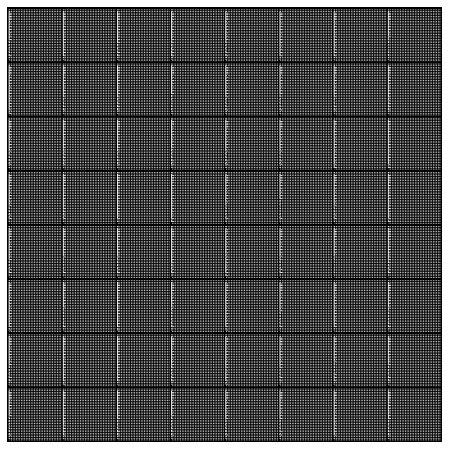

In [9]:
animate_gen_imgs()

# Trian : izif E

In [10]:
DC.eval()
D.eval()

kappa = 1.0
EC_losses = []

iters = 0
AE_img_list = []

def train_AE(epoch):
    global epochs
    global iters
    global EC_losses
    global AE_img_list
    
    # 인덱스 0부터 세기 시작
    # data[0].size():64x1x64x64(image) / data[1].size():64(label)
    for i,data in enumerate(data_loader,0):
        
        real_imgs = data[0].to(device)
        
        EC_optimizer.zero_grad()
        
        EC_validity = EC(real_imgs)
        
        fake_imgs = DC(EC_validity)
        
        _, real_features = D.forward(real_imgs)
        _, fake_features = D.forward(fake_imgs)
        
        
        # izif architecture
        imgs_loss = AE_criterion(real_imgs, fake_imgs)
        features_loss = AE_criterion(real_features, fake_features)
        EC_loss = imgs_loss + kappa*features_loss
        
        EC_loss.backward()
        EC_optimizer.step()
        
        # =============================================================
        # print
        # =============================================================
        print('[%d/%d][%d/%d]\n- E_loss: %.4f\n'
              %(epoch+1, epochs, i, len(data_loader), EC_loss.item()))
        
        # Save Losses for plotting later
        EC_losses.append(EC_loss.item())
        
        #Check how the generator is doing by saving G's output on noise_z
        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(data_loader)-1)):
            with torch.no_grad():
                fake = DC(EC_validity).detach().cpu()
            AE_img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1
        
#torch.save(E.state_dict(), 'E.ckpt')

In [11]:
for epoch in range(epochs):
    train_AE(epoch)

[1/100][0/21]
- E_loss: 1.3413

[1/100][1/21]
- E_loss: 1.3181

[1/100][2/21]
- E_loss: 1.2696

[1/100][3/21]
- E_loss: 1.3834

[1/100][4/21]
- E_loss: 1.3676

[1/100][5/21]
- E_loss: 1.3043

[1/100][6/21]
- E_loss: 1.3974

[1/100][7/21]
- E_loss: 1.3570

[1/100][8/21]
- E_loss: 1.3777

[1/100][9/21]
- E_loss: 1.4126

[1/100][10/21]
- E_loss: 1.3952

[1/100][11/21]
- E_loss: 1.2038

[1/100][12/21]
- E_loss: 1.3520

[1/100][13/21]
- E_loss: 1.4577

[1/100][14/21]
- E_loss: 1.3505

[1/100][15/21]
- E_loss: 1.3860

[1/100][16/21]
- E_loss: 1.4038

[1/100][17/21]
- E_loss: 1.3233

[1/100][18/21]
- E_loss: 1.3042

[1/100][19/21]
- E_loss: 1.3175

[1/100][20/21]
- E_loss: 1.3122

[2/100][0/21]
- E_loss: 1.3583

[2/100][1/21]
- E_loss: 1.2996

[2/100][2/21]
- E_loss: 1.4153

[2/100][3/21]
- E_loss: 1.4077

[2/100][4/21]
- E_loss: 1.3779

[2/100][5/21]
- E_loss: 1.3824

[2/100][6/21]
- E_loss: 1.3244

[2/100][7/21]
- E_loss: 1.3528

[2/100][8/21]
- E_loss: 1.2907

[2/100][9/21]
- E_loss: 1.338

[13/100][0/21]
- E_loss: 1.3896

[13/100][1/21]
- E_loss: 1.4129

[13/100][2/21]
- E_loss: 1.3193

[13/100][3/21]
- E_loss: 1.3884

[13/100][4/21]
- E_loss: 1.3735

[13/100][5/21]
- E_loss: 1.3035

[13/100][6/21]
- E_loss: 1.4397

[13/100][7/21]
- E_loss: 1.3743

[13/100][8/21]
- E_loss: 1.3626

[13/100][9/21]
- E_loss: 1.3965

[13/100][10/21]
- E_loss: 1.3177

[13/100][11/21]
- E_loss: 1.2916

[13/100][12/21]
- E_loss: 1.3399

[13/100][13/21]
- E_loss: 1.3171

[13/100][14/21]
- E_loss: 1.3726

[13/100][15/21]
- E_loss: 1.3882

[13/100][16/21]
- E_loss: 1.2838

[13/100][17/21]
- E_loss: 1.3390

[13/100][18/21]
- E_loss: 1.3430

[13/100][19/21]
- E_loss: 1.3082

[13/100][20/21]
- E_loss: 1.3596

[14/100][0/21]
- E_loss: 1.3096

[14/100][1/21]
- E_loss: 1.3568

[14/100][2/21]
- E_loss: 1.4253

[14/100][3/21]
- E_loss: 1.3383

[14/100][4/21]
- E_loss: 1.3812

[14/100][5/21]
- E_loss: 1.4160

[14/100][6/21]
- E_loss: 1.3209

[14/100][7/21]
- E_loss: 1.2433

[14/100][8/21]
- E_loss: 1.3617


[24/100][15/21]
- E_loss: 1.3490

[24/100][16/21]
- E_loss: 1.3735

[24/100][17/21]
- E_loss: 1.3347

[24/100][18/21]
- E_loss: 1.3511

[24/100][19/21]
- E_loss: 1.3260

[24/100][20/21]
- E_loss: 1.2819

[25/100][0/21]
- E_loss: 1.3645

[25/100][1/21]
- E_loss: 1.3026

[25/100][2/21]
- E_loss: 1.3424

[25/100][3/21]
- E_loss: 1.2747

[25/100][4/21]
- E_loss: 1.3398

[25/100][5/21]
- E_loss: 1.3942

[25/100][6/21]
- E_loss: 1.3515

[25/100][7/21]
- E_loss: 1.4033

[25/100][8/21]
- E_loss: 1.3822

[25/100][9/21]
- E_loss: 1.3041

[25/100][10/21]
- E_loss: 1.4160

[25/100][11/21]
- E_loss: 1.3630

[25/100][12/21]
- E_loss: 1.3395

[25/100][13/21]
- E_loss: 1.4101

[25/100][14/21]
- E_loss: 1.3653

[25/100][15/21]
- E_loss: 1.3440

[25/100][16/21]
- E_loss: 1.3388

[25/100][17/21]
- E_loss: 1.4015

[25/100][18/21]
- E_loss: 1.3073

[25/100][19/21]
- E_loss: 1.3341

[25/100][20/21]
- E_loss: 1.3218

[26/100][0/21]
- E_loss: 1.3315

[26/100][1/21]
- E_loss: 1.3843

[26/100][2/21]
- E_loss: 1

[36/100][9/21]
- E_loss: 1.3633

[36/100][10/21]
- E_loss: 1.3583

[36/100][11/21]
- E_loss: 1.3136

[36/100][12/21]
- E_loss: 1.3691

[36/100][13/21]
- E_loss: 1.3406

[36/100][14/21]
- E_loss: 1.4011

[36/100][15/21]
- E_loss: 1.3691

[36/100][16/21]
- E_loss: 1.3521

[36/100][17/21]
- E_loss: 1.2873

[36/100][18/21]
- E_loss: 1.3969

[36/100][19/21]
- E_loss: 1.3001

[36/100][20/21]
- E_loss: 1.3079

[37/100][0/21]
- E_loss: 1.3369

[37/100][1/21]
- E_loss: 1.2741

[37/100][2/21]
- E_loss: 1.4000

[37/100][3/21]
- E_loss: 1.3746

[37/100][4/21]
- E_loss: 1.3439

[37/100][5/21]
- E_loss: 1.3594

[37/100][6/21]
- E_loss: 1.3121

[37/100][7/21]
- E_loss: 1.2874

[37/100][8/21]
- E_loss: 1.2681

[37/100][9/21]
- E_loss: 1.3290

[37/100][10/21]
- E_loss: 1.3649

[37/100][11/21]
- E_loss: 1.4442

[37/100][12/21]
- E_loss: 1.3362

[37/100][13/21]
- E_loss: 1.3756

[37/100][14/21]
- E_loss: 1.3790

[37/100][15/21]
- E_loss: 1.3635

[37/100][16/21]
- E_loss: 1.3785

[37/100][17/21]
- E_loss:

[48/100][3/21]
- E_loss: 1.4685

[48/100][4/21]
- E_loss: 1.2981

[48/100][5/21]
- E_loss: 1.3565

[48/100][6/21]
- E_loss: 1.3126

[48/100][7/21]
- E_loss: 1.3115

[48/100][8/21]
- E_loss: 1.4127

[48/100][9/21]
- E_loss: 1.3720

[48/100][10/21]
- E_loss: 1.3714

[48/100][11/21]
- E_loss: 1.3900

[48/100][12/21]
- E_loss: 1.3178

[48/100][13/21]
- E_loss: 1.3464

[48/100][14/21]
- E_loss: 1.2961

[48/100][15/21]
- E_loss: 1.3416

[48/100][16/21]
- E_loss: 1.2982

[48/100][17/21]
- E_loss: 1.2962

[48/100][18/21]
- E_loss: 1.4208

[48/100][19/21]
- E_loss: 1.3123

[48/100][20/21]
- E_loss: 1.3398

[49/100][0/21]
- E_loss: 1.2994

[49/100][1/21]
- E_loss: 1.3451

[49/100][2/21]
- E_loss: 1.3743

[49/100][3/21]
- E_loss: 1.4322

[49/100][4/21]
- E_loss: 1.2964

[49/100][5/21]
- E_loss: 1.2694

[49/100][6/21]
- E_loss: 1.3716

[49/100][7/21]
- E_loss: 1.3845

[49/100][8/21]
- E_loss: 1.3187

[49/100][9/21]
- E_loss: 1.3838

[49/100][10/21]
- E_loss: 1.3409

[49/100][11/21]
- E_loss: 1.357

[59/100][18/21]
- E_loss: 1.3581

[59/100][19/21]
- E_loss: 1.2997

[59/100][20/21]
- E_loss: 1.3313

[60/100][0/21]
- E_loss: 1.2742

[60/100][1/21]
- E_loss: 1.2940

[60/100][2/21]
- E_loss: 1.3195

[60/100][3/21]
- E_loss: 1.3460

[60/100][4/21]
- E_loss: 1.3200

[60/100][5/21]
- E_loss: 1.3467

[60/100][6/21]
- E_loss: 1.4240

[60/100][7/21]
- E_loss: 1.3335

[60/100][8/21]
- E_loss: 1.3517

[60/100][9/21]
- E_loss: 1.3847

[60/100][10/21]
- E_loss: 1.3772

[60/100][11/21]
- E_loss: 1.3220

[60/100][12/21]
- E_loss: 1.4638

[60/100][13/21]
- E_loss: 1.2969

[60/100][14/21]
- E_loss: 1.3776

[60/100][15/21]
- E_loss: 1.4092

[60/100][16/21]
- E_loss: 1.3735

[60/100][17/21]
- E_loss: 1.3209

[60/100][18/21]
- E_loss: 1.3036

[60/100][19/21]
- E_loss: 1.4362

[60/100][20/21]
- E_loss: 1.3552

[61/100][0/21]
- E_loss: 1.4677

[61/100][1/21]
- E_loss: 1.3198

[61/100][2/21]
- E_loss: 1.3681

[61/100][3/21]
- E_loss: 1.3301

[61/100][4/21]
- E_loss: 1.4301

[61/100][5/21]
- E_loss: 1.37

[71/100][12/21]
- E_loss: 1.3567

[71/100][13/21]
- E_loss: 1.3068

[71/100][14/21]
- E_loss: 1.3587

[71/100][15/21]
- E_loss: 1.4070

[71/100][16/21]
- E_loss: 1.3510

[71/100][17/21]
- E_loss: 1.3469

[71/100][18/21]
- E_loss: 1.3854

[71/100][19/21]
- E_loss: 1.3091

[71/100][20/21]
- E_loss: 1.3310

[72/100][0/21]
- E_loss: 1.4029

[72/100][1/21]
- E_loss: 1.3236

[72/100][2/21]
- E_loss: 1.3403

[72/100][3/21]
- E_loss: 1.3417

[72/100][4/21]
- E_loss: 1.3241

[72/100][5/21]
- E_loss: 1.3941

[72/100][6/21]
- E_loss: 1.2654

[72/100][7/21]
- E_loss: 1.3666

[72/100][8/21]
- E_loss: 1.3250

[72/100][9/21]
- E_loss: 1.3998

[72/100][10/21]
- E_loss: 1.3767

[72/100][11/21]
- E_loss: 1.3734

[72/100][12/21]
- E_loss: 1.3367

[72/100][13/21]
- E_loss: 1.3145

[72/100][14/21]
- E_loss: 1.3979

[72/100][15/21]
- E_loss: 1.3934

[72/100][16/21]
- E_loss: 1.3596

[72/100][17/21]
- E_loss: 1.3016

[72/100][18/21]
- E_loss: 1.3512

[72/100][19/21]
- E_loss: 1.3362

[72/100][20/21]
- E_loss

[83/100][6/21]
- E_loss: 1.3705

[83/100][7/21]
- E_loss: 1.3474

[83/100][8/21]
- E_loss: 1.3722

[83/100][9/21]
- E_loss: 1.3735

[83/100][10/21]
- E_loss: 1.4190

[83/100][11/21]
- E_loss: 1.3247

[83/100][12/21]
- E_loss: 1.3585

[83/100][13/21]
- E_loss: 1.3369

[83/100][14/21]
- E_loss: 1.3814

[83/100][15/21]
- E_loss: 1.3216

[83/100][16/21]
- E_loss: 1.3664

[83/100][17/21]
- E_loss: 1.3542

[83/100][18/21]
- E_loss: 1.3135

[83/100][19/21]
- E_loss: 1.3635

[83/100][20/21]
- E_loss: 1.3032

[84/100][0/21]
- E_loss: 1.3114

[84/100][1/21]
- E_loss: 1.3247

[84/100][2/21]
- E_loss: 1.3382

[84/100][3/21]
- E_loss: 1.3613

[84/100][4/21]
- E_loss: 1.3696

[84/100][5/21]
- E_loss: 1.3409

[84/100][6/21]
- E_loss: 1.3332

[84/100][7/21]
- E_loss: 1.3400

[84/100][8/21]
- E_loss: 1.3346

[84/100][9/21]
- E_loss: 1.3821

[84/100][10/21]
- E_loss: 1.3444

[84/100][11/21]
- E_loss: 1.4254

[84/100][12/21]
- E_loss: 1.3340

[84/100][13/21]
- E_loss: 1.3609

[84/100][14/21]
- E_loss: 1.

[95/100][0/21]
- E_loss: 1.3535

[95/100][1/21]
- E_loss: 1.3715

[95/100][2/21]
- E_loss: 1.3042

[95/100][3/21]
- E_loss: 1.3391

[95/100][4/21]
- E_loss: 1.2716

[95/100][5/21]
- E_loss: 1.3352

[95/100][6/21]
- E_loss: 1.3487

[95/100][7/21]
- E_loss: 1.3422

[95/100][8/21]
- E_loss: 1.3796

[95/100][9/21]
- E_loss: 1.3361

[95/100][10/21]
- E_loss: 1.3663

[95/100][11/21]
- E_loss: 1.3809

[95/100][12/21]
- E_loss: 1.3267

[95/100][13/21]
- E_loss: 1.3738

[95/100][14/21]
- E_loss: 1.4002

[95/100][15/21]
- E_loss: 1.3200

[95/100][16/21]
- E_loss: 1.4260

[95/100][17/21]
- E_loss: 1.3214

[95/100][18/21]
- E_loss: 1.3755

[95/100][19/21]
- E_loss: 1.3013

[95/100][20/21]
- E_loss: 1.3801

[96/100][0/21]
- E_loss: 1.3604

[96/100][1/21]
- E_loss: 1.3224

[96/100][2/21]
- E_loss: 1.3499

[96/100][3/21]
- E_loss: 1.4066

[96/100][4/21]
- E_loss: 1.3398

[96/100][5/21]
- E_loss: 1.4180

[96/100][6/21]
- E_loss: 1.3472

[96/100][7/21]
- E_loss: 1.3624

[96/100][8/21]
- E_loss: 1.3662


# Loss Graph

In [12]:
def plot_train_loss():
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(DC_losses, label="G")
    plt.plot(D_losses, label="D")
    plt.plot(EC_losses, label="E")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

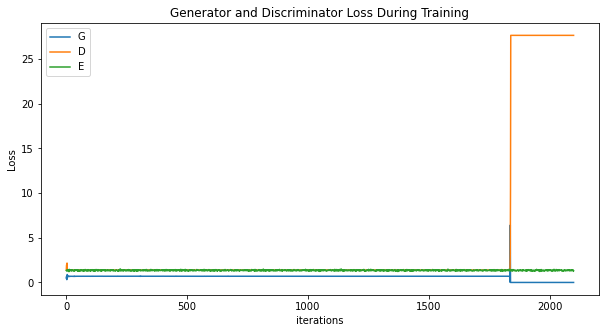

In [13]:
plot_train_loss()

---

# Test Data

In [14]:
#test_data_root = "../../dataset/test/test_DualPhaseSteel"
CFRP_test_data_root = "../../dataset/test/test_CFRP"

test_data_set = dataset.ImageFolder(root = CFRP_test_data_root, # test_data_root,
                           transform = transforms.Compose([
                                  transforms.Resize(img_size),
                                  transforms.CenterCrop(img_size),
                                  torchvision.transforms.Grayscale(channel),
                                  transforms.ToTensor(),
                                  transforms.Normalize((0.5,),(0.5,))
                              ]))

# 배치로 나누고 셔플하기
test_data_loader = torch.utils.data.DataLoader(test_data_set, batch_size = 1,
                                              shuffle = False, num_workers = workers)

# 이상 픽셀 수 확인 함수

In [15]:
def count_el_not_0(diff_img):
    count_el_not_0 = 0
    
    col_size = diff_img.shape[0]
    row_size = diff_img.shape[1]
    
    #print(col_size, row_size)
    
    for col in range(col_size):
        for row in range(row_size):
            if diff_img[col][row] != 0:
                count_el_not_0 += 1
                
    return count_el_not_0

# img 비교 함수

In [16]:
def compare_imgs(real_img, generated_img, i, score, reverse=False, threshold=50):
    real_img = real_img.cpu().data.numpy().reshape(img_size, img_size) * 255
    generated_img = generated_img.cpu().data.numpy().reshape(img_size, img_size) * 255
    
    negative = np.zeros_like(real_img)

    if not reverse:
        diff_img = real_img - generated_img
    else:
        diff_img = generated_img - real_img

    diff_img[diff_img <= threshold] = 0

    # 분율 추출
    diff_cnts.append(count_el_not_0(diff_img))
    # 분산 추출
    diff_points.append(np.where(diff_img > threshold))
    
    anomaly_img = np.zeros(shape=(img_size, img_size, 3))
    anomaly_img[:, :, 0] = real_img - diff_img
    anomaly_img[:, :, 1] = real_img - diff_img
    anomaly_img[:, :, 2] = real_img - diff_img
    anomaly_img[:, :, 0] = anomaly_img[:,:,0] + diff_img
    anomaly_img = anomaly_img.astype(np.uint8)

    # anomaly_img 추출
    anomaly_imgs.append(anomaly_img)
    
    fig, plots = plt.subplots(1, 4)

    fig.suptitle(f'Anomaly - (anomaly score: {score:.4})')
    
    fig.set_figwidth(9)
    fig.set_tight_layout(True)
    plots = plots.reshape(-1)
    plots[0].imshow(real_img, cmap='gray', label = "real")
    plots[1].imshow(generated_img, cmap='gray')
    plots[2].imshow(diff_img, cmap='gray')
    plots[3].imshow(anomaly_img)
    
    plots[0].set_title('real')
    plots[1].set_title('generated')
    plots[2].set_title('difference')
    plots[3].set_title('Anomaly Detection')
    plt.show()

# Test

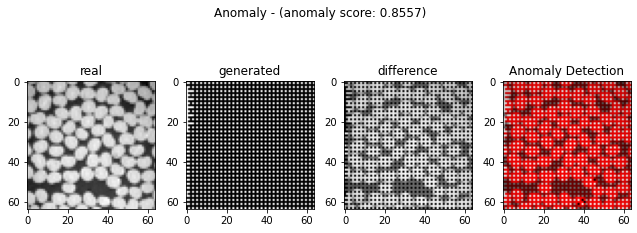

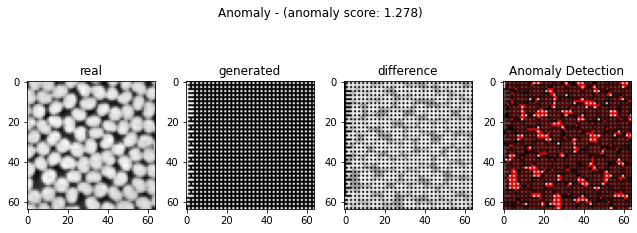

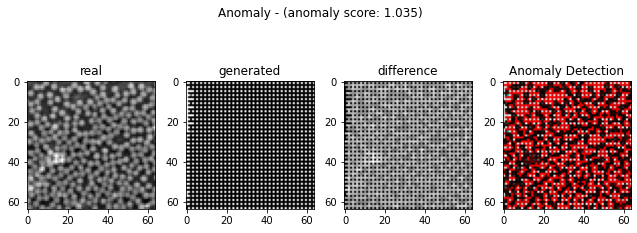

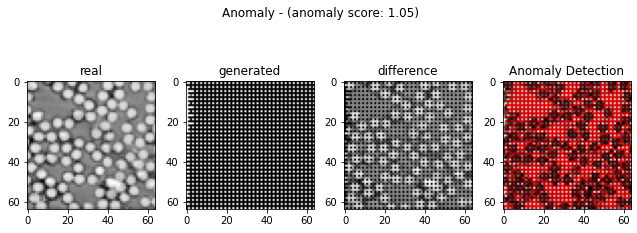

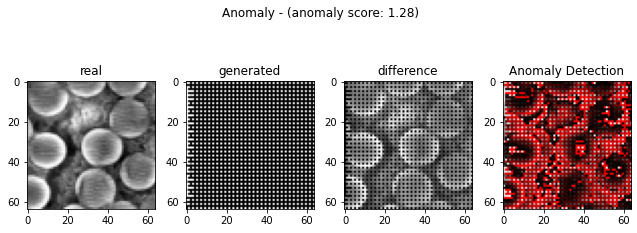

...

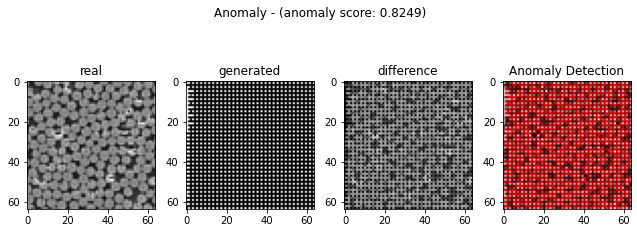

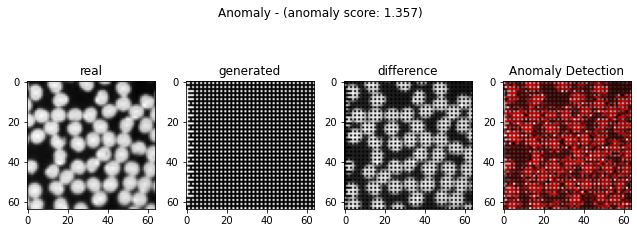

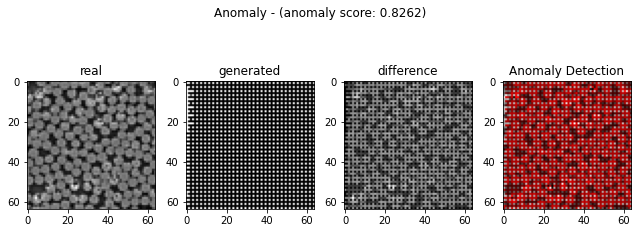

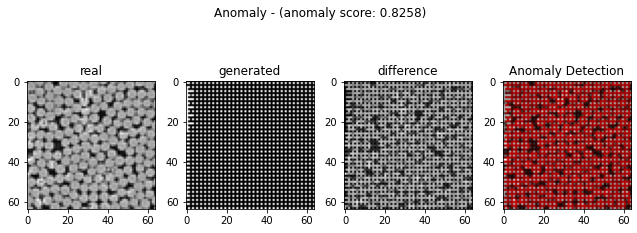

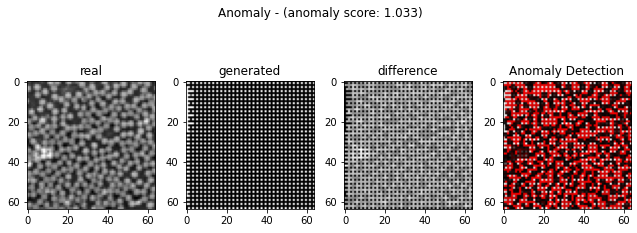

In [17]:
diff_cnts = []
diff_points = []
anomaly_imgs = []

ano_criterion = nn.MSELoss()
DC.eval()
D.eval()
EC.eval()

# with open("score.csv", "w") as f:
#         f.write("label,img_distance,anomaly_score,z_distance\n")

for i, data in enumerate(test_data_loader, 0):
    real_img = data[0].to(device)

    real_z = EC(real_img) # 진짜 이미지의 latent vector
    fake_img = DC(real_z) # DC에 넣어서 가짜 이미지 생성.
    fake_z = EC(fake_img) # torch.Size([1, 100]) --> latent 진짜 이미지와 매핑된 가짜 이미지의 latent vector

    _, real_feature = D.forward(real_img) # 1, 256
    _, fake_feature = D.forward(fake_img)

    img_distance = ano_criterion(fake_img, real_img)
    loss_feature = ano_criterion(fake_feature, real_feature)

    anomaly_score = img_distance + kappa*loss_feature

    z_distance = ano_criterion(fake_z, real_z)
    
#     with open("score.csv", "a") as f:
#             f.write(f"{label.item()},{img_distance},"
#                     f"{anomaly_score},{z_distance}\n")
            
#     print(f"{label.item()}, {img_distance}, "
#           f"{anomaly_score}, {z_distance}\n")
    compare_imgs(real_img, fake_img, i, anomaly_score, reverse = False, threshold = 0.3)

---

# 분율 추출

In [18]:
diff_cnts = np.array(diff_cnts)

diff_fraction = diff_cnts / img_size ** 2

print(diff_fraction)

[0.73828125 0.73144531 0.73828125 0.73828125 0.73339844 0.73828125
 0.73632812 0.73120117 0.73828125 0.73828125 0.73803711 0.73828125
 0.73803711 0.73828125 0.73339844 0.73828125 0.73828125 0.73828125
 0.73754883 0.73754883 0.73803711 0.73779297 0.73779297 0.73803711
 0.73535156 0.73803711 0.73461914 0.73828125 0.73730469 0.73681641
 0.73803711 0.73828125 0.73730469 0.73803711 0.73291016 0.73828125
 0.73608398 0.73828125 0.73754883 0.73486328 0.73803711 0.73803711
 0.73779297 0.73779297 0.73413086 0.73144531 0.73803711 0.73803711
 0.73828125 0.73413086 0.73120117 0.73803711 0.73779297 0.73803711
 0.7331543  0.73828125 0.73242188 0.73803711 0.73828125 0.73828125]


In [19]:
sum(diff_fraction)/len(diff_fraction)

0.73681640625

---

# 분산 추출

In [20]:
from scipy import stats
from extended_int import int_inf

corr_coeffis = []
corr_p_vals = []

def cal_corr_coeffis():
    for idx in range(len(test_data_loader)):
        x_points = diff_points[idx][0]
        y_points = diff_points[idx][1]
        
        
        if len(x_points) > 0:
            corr_coeffi, corr_p_val = stats.pearsonr(x_points, y_points)
        else:
            corr_coeffi, corr_p_val = -int_inf, -int_inf
        
        corr_coeffis.append(corr_coeffi)
        corr_p_vals.append(corr_p_val)

In [21]:
cal_corr_coeffis()

print(corr_coeffis)

[-0.008547417906092512, -0.004751327842742303, -0.008547417906092512, -0.008547417906092512, -0.004384060366446642, -0.01003303243504661, -0.011104464760530496, -0.0038620319373920157, -0.008547417906092512, -0.008547417906092512, -0.00927113384946546, -0.008547417906092512, -0.008659039322326726, -0.008547417906092512, -0.009190922174935057, -0.008547417906092512, -0.008547417906092512, -0.008547417906092512, -0.007272745384407079, -0.009577117309294635, -0.00927113384946546, -0.010339900407050906, -0.008851874073761267, -0.008739997420124187, -0.00574096063063106, -0.008659039322326726, -0.006472843545982565, -0.008547417906092512, -0.007464903303675296, -0.006315014826084286, -0.00927113384946546, -0.008547417906092512, -0.007464903303675296, -0.00927113384946546, -0.008457342194770151, -0.008547417906092512, -0.011063638271310548, -0.008547417906092512, -0.008825353068818011, -0.0027970504144627407, -0.00927113384946546, -0.008739997420124187, -0.009383498899864185, -0.009383498899

---

# 모델 저장 및 읽기

In [22]:
save_file = "./pretrained/pretrained.pth"

def save_pretrained():
    pretrained = {
        "D" : D.state_dict(),
        "DC" : DC.state_dict(),
        "EC" : EC.state_dict()
    }

    if not os.path.isdir("pretrained"):
        os.mkdir("pretrained")
    torch.save(pretrained, save_file)

In [23]:
save_pretrained()

In [24]:
pretrained_D = Discriminator().to(device)
pretrained_DC = Decoder().to(device)
pretrained_EC = Encoder().to(device)

def load_pretrained():
    global pretrained_D
    global pretrained_DC
    global pretrained_EC
    
    assert os.path.isdir("pretrained"), "Error : no pretrained dir found!"
    
    pretrained = torch.load(save_file)
    
    pretrained_D.load_state_dict(pretrained["D"])
    pretrained_DC.load_state_dict(pretrained["DC"])
    pretrained_EC.load_state_dict(pretrained["EC"])
    
    #print("pretrained_D :", pretrained_D)
    #print("pretrained_G :", pretrained_DC)
    #print("pretrained_E :", pretrained_EC)

In [25]:
load_pretrained()

In [26]:
def test():
    ano_criterion = nn.MSELoss()
    pretrained_DC.eval()
    pretrained_D.eval()
    pretrained_EC.eval()

    # with open("score.csv", "w") as f:
    #         f.write("label,img_distance,anomaly_score,z_distance\n")

    for i, data in enumerate(test_data_loader, 0):
        real_img = data[0].to(device)

        real_z = pretrained_EC(real_img) # 진짜 이미지의 latent vector
        fake_img = pretrained_DC(real_z) # DC에 넣어서 가짜 이미지 생성.
        fake_z = pretrained_EC(fake_img) # torch.Size([1, 100]) --> latent 진짜 이미지와 매핑된 가짜 이미지의 latent vector

        _, real_feature = pretrained_D.forward(real_img) # 1, 256
        _, fake_feature = pretrained_D.forward(fake_img)

        img_distance = ano_criterion(fake_img, real_img)
        loss_feature = ano_criterion(fake_feature, real_feature)

        anomaly_score = img_distance + kappa*loss_feature

        z_distance = ano_criterion(fake_z, real_z)

    #     with open("score.csv", "a") as f:
    #             f.write(f"{label.item()},{img_distance},"
    #                     f"{anomaly_score},{z_distance}\n")

    #     print(f"{label.item()}, {img_distance}, "
    #           f"{anomaly_score}, {z_distance}\n")
        compare_imgs(real_img, fake_img, i, anomaly_score, reverse = False, threshold = 0.3)

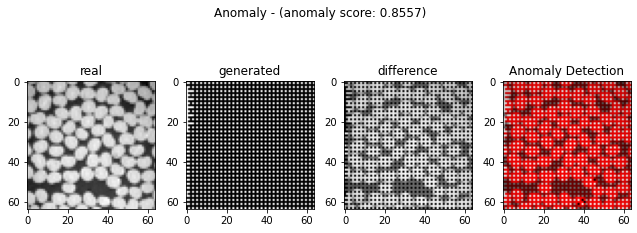

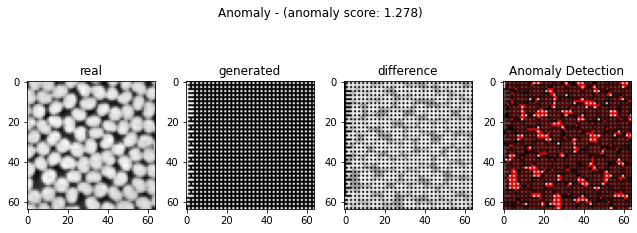

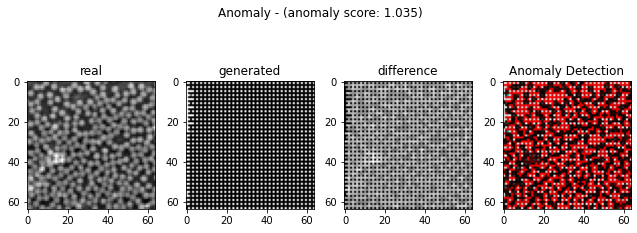

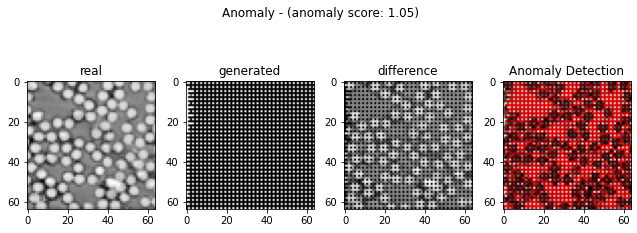

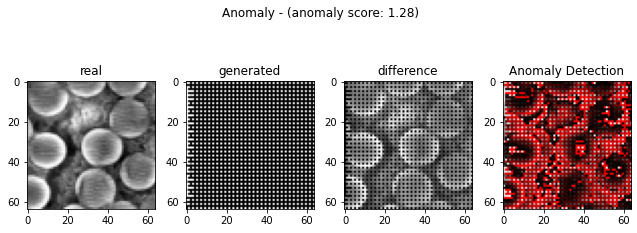

...

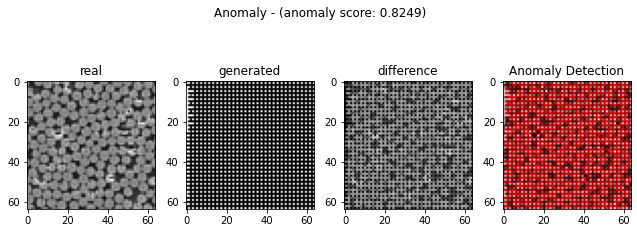

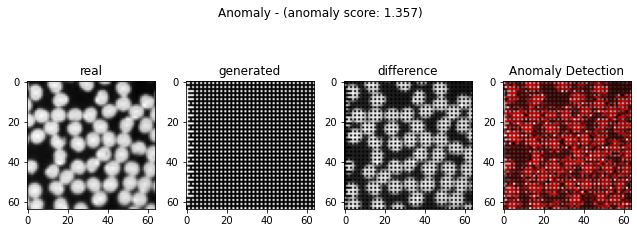

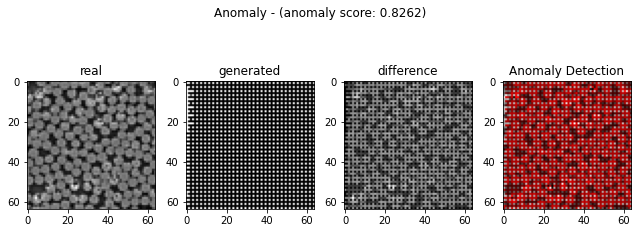

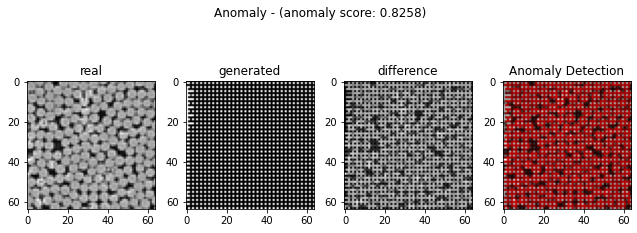

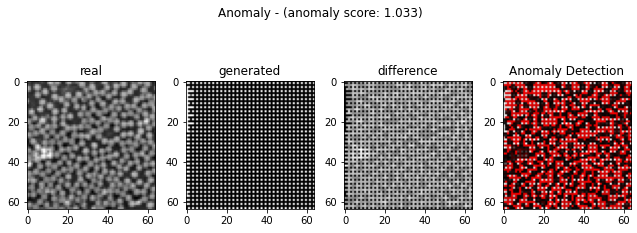

In [27]:
diff_cnts = []
diff_points = []
anomaly_imgs = []

corr_coeffis = []
corr_p_vals = []

test()

In [28]:
diff_cnts = np.array(diff_cnts)

diff_fraction = diff_cnts / img_size ** 2

print(diff_fraction)

[0.73828125 0.73144531 0.73828125 0.73828125 0.73339844 0.73828125
 0.73632812 0.73120117 0.73828125 0.73828125 0.73803711 0.73828125
 0.73803711 0.73828125 0.73339844 0.73828125 0.73828125 0.73828125
 0.73754883 0.73754883 0.73803711 0.73779297 0.73779297 0.73803711
 0.73535156 0.73803711 0.73461914 0.73828125 0.73730469 0.73681641
 0.73803711 0.73828125 0.73730469 0.73803711 0.73291016 0.73828125
 0.73608398 0.73828125 0.73754883 0.73486328 0.73803711 0.73803711
 0.73779297 0.73779297 0.73413086 0.73144531 0.73803711 0.73803711
 0.73828125 0.73413086 0.73120117 0.73803711 0.73779297 0.73803711
 0.7331543  0.73828125 0.73242188 0.73803711 0.73828125 0.73828125]


In [29]:
cal_corr_coeffis()

print(corr_coeffis)

[-0.008547417906092512, -0.004751327842742303, -0.008547417906092512, -0.008547417906092512, -0.004384060366446642, -0.01003303243504661, -0.011104464760530496, -0.0038620319373920157, -0.008547417906092512, -0.008547417906092512, -0.00927113384946546, -0.008547417906092512, -0.008659039322326726, -0.008547417906092512, -0.009190922174935057, -0.008547417906092512, -0.008547417906092512, -0.008547417906092512, -0.007272745384407079, -0.009577117309294635, -0.00927113384946546, -0.010339900407050906, -0.008851874073761267, -0.008739997420124187, -0.00574096063063106, -0.008659039322326726, -0.006472843545982565, -0.008547417906092512, -0.007464903303675296, -0.006315014826084286, -0.00927113384946546, -0.008547417906092512, -0.007464903303675296, -0.00927113384946546, -0.008457342194770151, -0.008547417906092512, -0.011063638271310548, -0.008547417906092512, -0.008825353068818011, -0.0027970504144627407, -0.00927113384946546, -0.008739997420124187, -0.009383498899864185, -0.009383498899

---

# anomaly detection 이미지 추출

In [30]:
anomaly_imgs

[array([[[187,   4,   4],
         [191,   1,   1],
         [193,   1,   1],
         ...,
         [179,   1,   1],
         [185,   1,   1],
         [185,   1,   1]],
 
        [[136, 136, 136],
         [180, 180, 180],
         [181,   1,   1],
         ...,
         [190, 190, 190],
         [183,   1,   1],
         [188, 188, 188]],
 
        [[185,   2,   2],
         [179,   1,   1],
         [127,   1,   1],
         ...,
         [187,   1,   1],
         [183,   1,   1],
         [189,   1,   1]],
 
        ...,
 
        [[180, 180, 180],
         [206, 206, 206],
         [205,   1,   1],
         ...,
         [226, 226, 226],
         [231,   1,   1],
         [150, 150, 150]],
 
        [[171,   1,   1],
         [113,   1,   1],
         [197,   1,   1],
         ...,
         [227,   1,   1],
         [217,   1,   1],
         [165,   1,   1]],
 
        [[187,   1,   1],
         [166, 166, 166],
         [221,   1,   1],
         ...,
         [226, 226, 226],
  

# 이미지 저장 함수

In [31]:
import cv2

def save_imgs(folder, imgs):
    if not os.path.isdir("anomaly_imgs"):
        os.mkdir("anomaly_imgs")
    
    for i in range(len(imgs)):
        cv2.imwrite('%s/%d.png' %(folder,i), imgs[i]) #이미지 저장할 경로 설정을 여기서 한다.
    print("image saving complete")

In [32]:
save_imgs("./anomaly_imgs", anomaly_imgs)

image saving complete


---

# 티타늄(Ti64) 상대 밀도 계산

In [33]:
Ti64_density = 4.43

Ti64_rel_densitys = np.array([])

Ti64_rel_densitys = diff_fraction * Ti64_density

print(Ti64_rel_densitys)

[3.27058594 3.24030273 3.27058594 3.27058594 3.24895508 3.27058594
 3.26193359 3.23922119 3.27058594 3.27058594 3.26950439 3.27058594
 3.26950439 3.27058594 3.24895508 3.27058594 3.27058594 3.27058594
 3.26734131 3.26734131 3.26950439 3.26842285 3.26842285 3.26950439
 3.25760742 3.26950439 3.25436279 3.27058594 3.26625977 3.26409668
 3.26950439 3.27058594 3.26625977 3.26950439 3.24679199 3.27058594
 3.26085205 3.27058594 3.26734131 3.25544434 3.26950439 3.26950439
 3.26842285 3.26842285 3.25219971 3.24030273 3.26950439 3.26950439
 3.27058594 3.25219971 3.23922119 3.26950439 3.26842285 3.26950439
 3.24787354 3.27058594 3.24462891 3.26950439 3.27058594 3.27058594]
